In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims
from matplotlib import pyplot

import warnings
warnings.filterwarnings('ignore')

from tensorflow.keras.applications.efficientnet import preprocess_input
import tensorflow as tf

In [ ]:
model = VGG16()

# Summary of the model
model.summary()

553467096/553467096 ━━━━━━━━━━━━━━━━━━━━ 7s 0us/step


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 4096)                │     102,764,544 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 138,357,544 (527.79 MB)

 Trainable params: 138,357,544 (527.79 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:

image = load_img('/content/drive/My Drive/Mouth/OSCC Tumor/img12.jpg', target_size=(224, 224))
image = img_to_array(image)
# expand dimensions so that it represents a single 'sample'
image = expand_dims(image, axis=0)

image = preprocess_input(image)

In [ ]:
model2 = VGG16()


blocks = [ 2,3,4, 5 ,6, 7]
outputs = [model2.layers[i].output for i in blocks]

model2 = Model( inputs= model2.inputs, outputs = outputs)

features = model.predict(image)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


ValueError: num must be an integer with 1 <= num <= 64, not 65

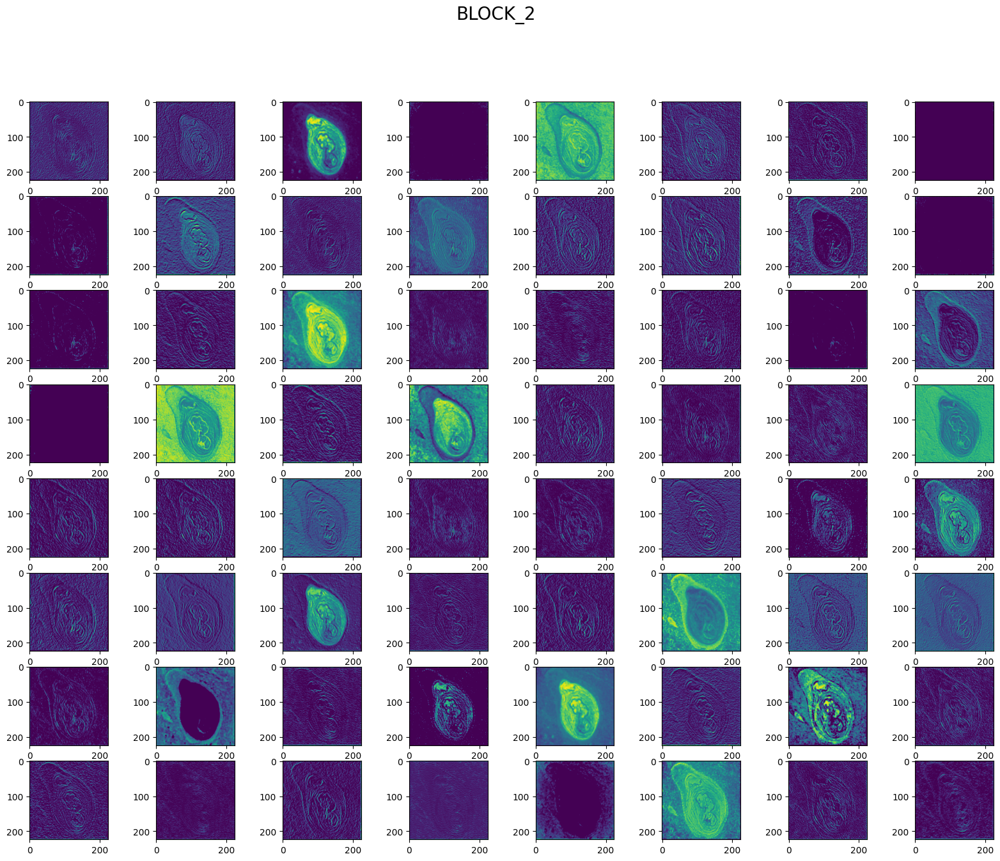

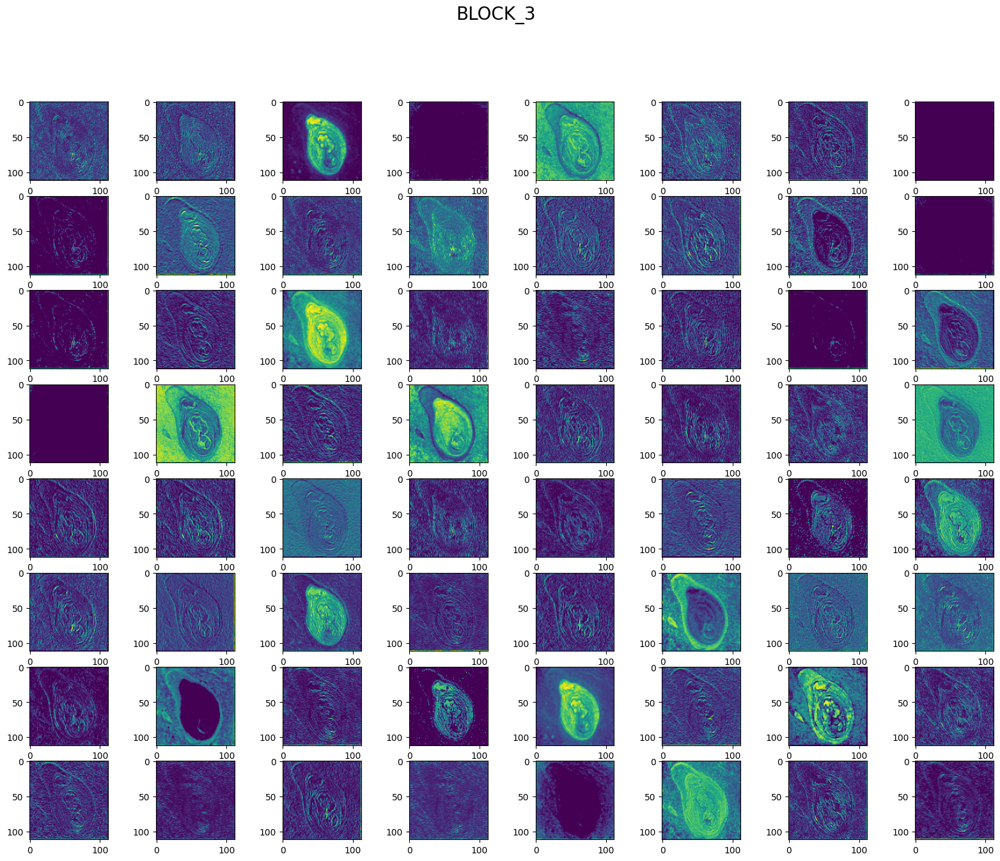

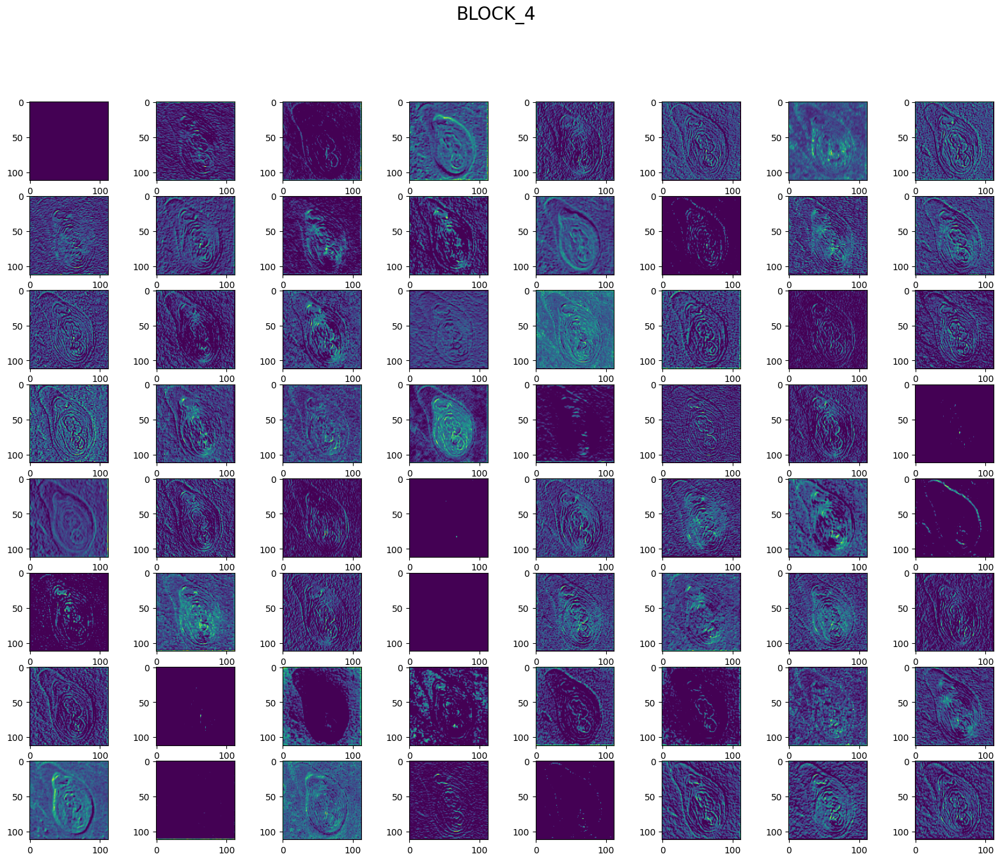

In [ ]:
feature_map = model2.predict(image)

for i,fmap in zip(blocks,feature_map):
    fig = pyplot.figure(figsize=(20,15))
    #https://stackoverflow.com/a/12444777
    fig.suptitle("BLOCK_{}".format(i) , fontsize=20)
    for i in range(1,features.shape[3]+1):

        pyplot.subplot(8,8,i)
        pyplot.imshow(fmap[0,:,:,i-1])

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 904ms/step


ValueError: num must be an integer with 1 <= num <= 64, not 65

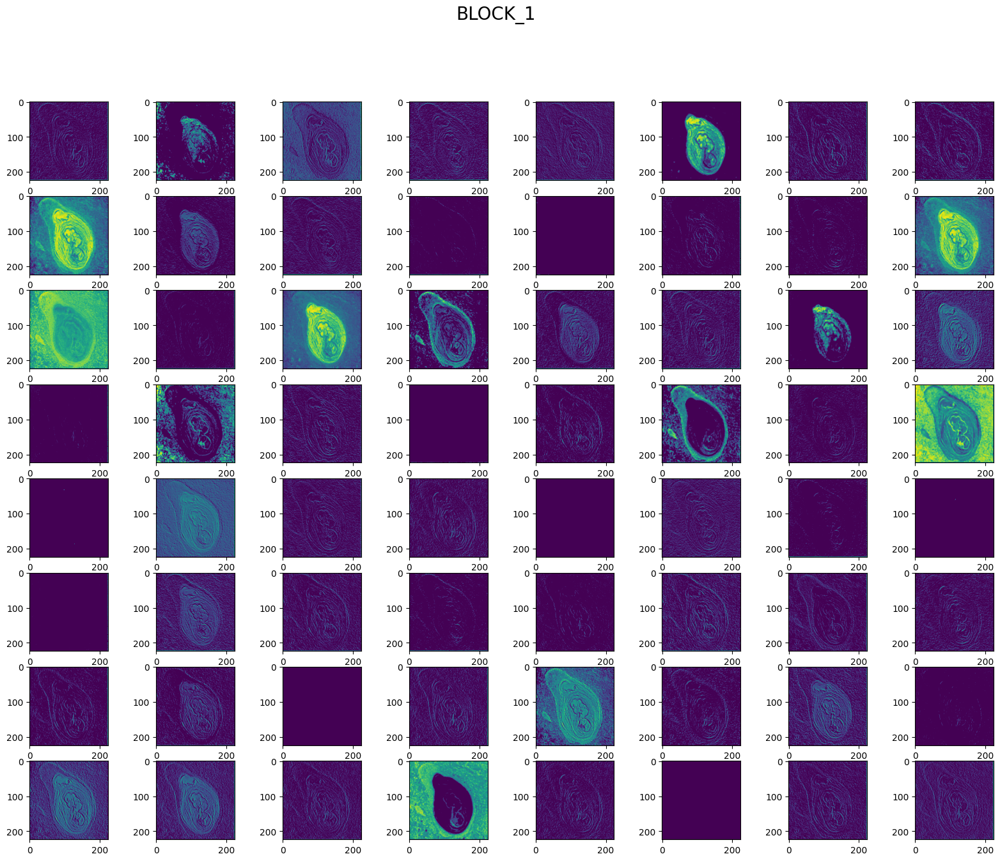

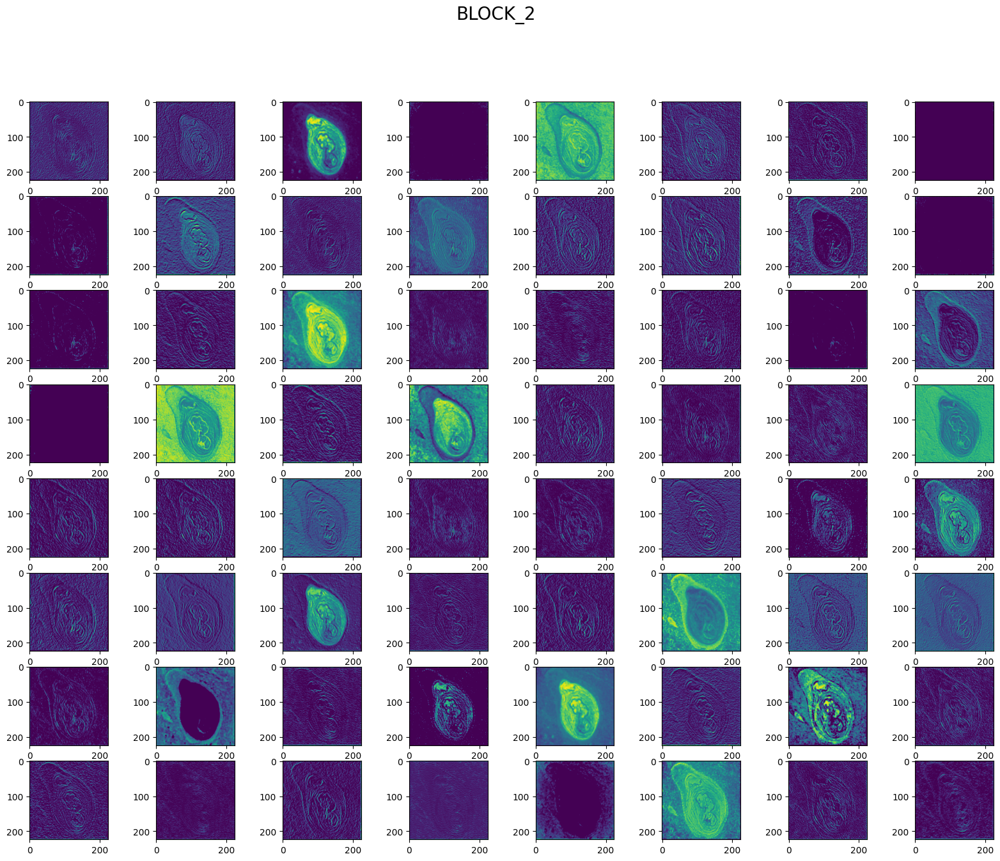

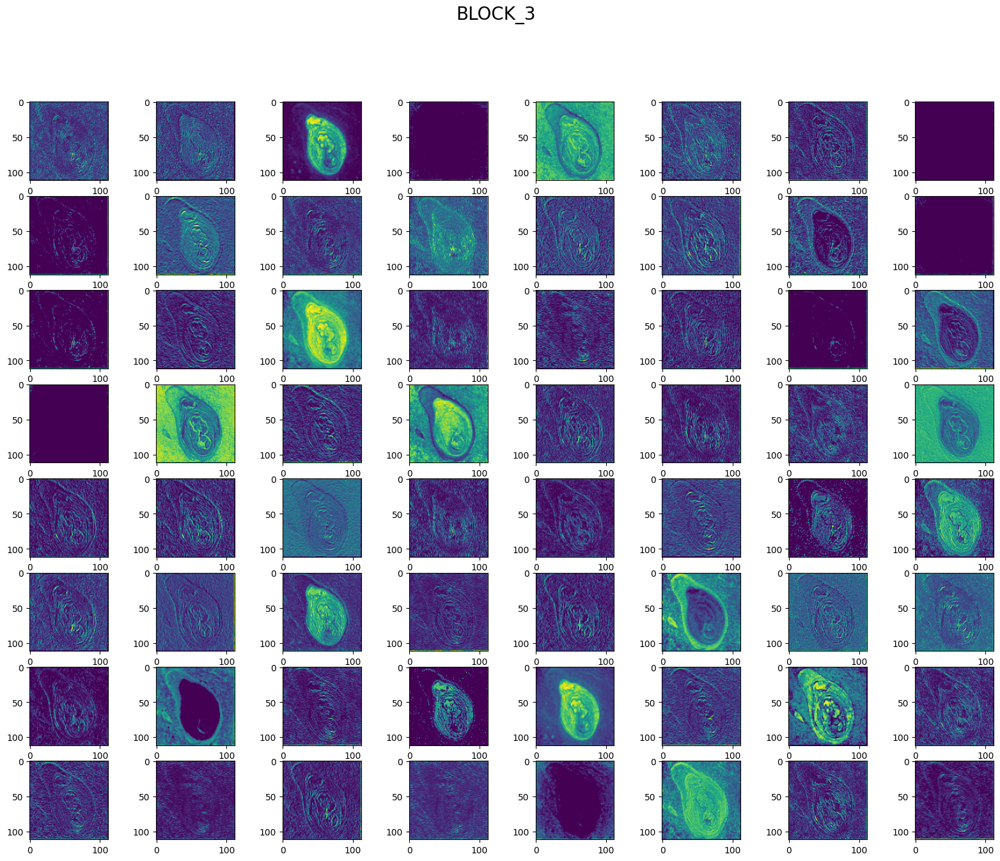

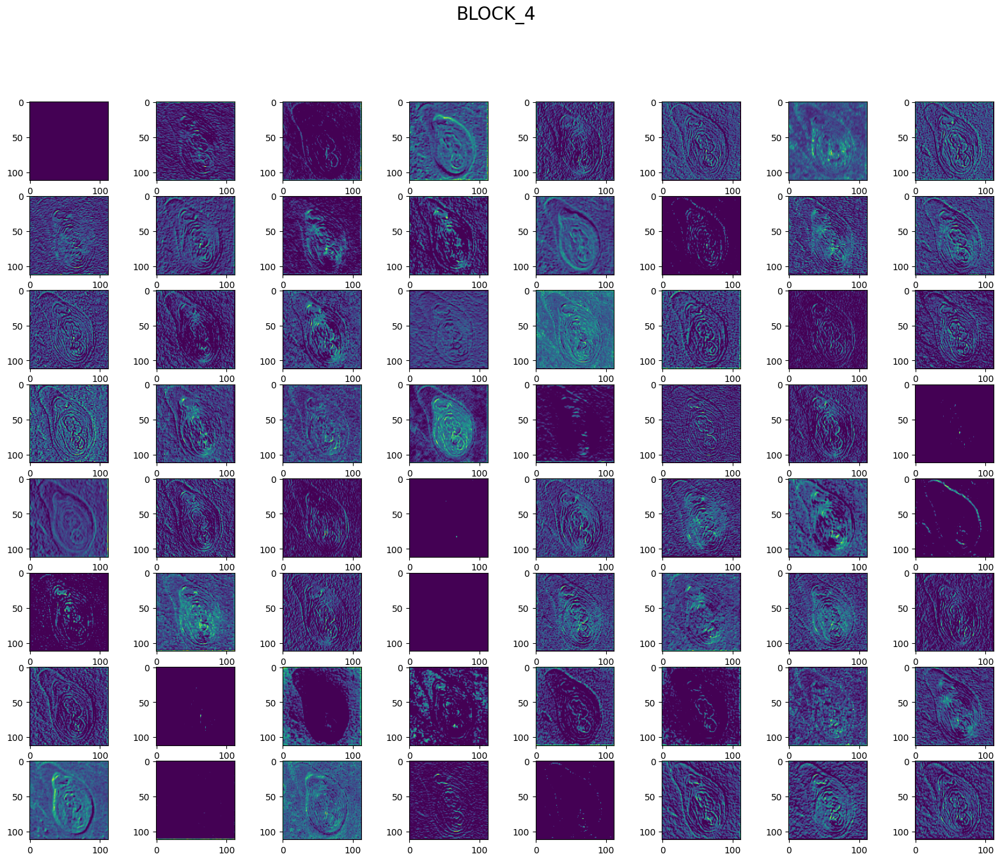

In [ ]:
feature_map = model2.predict(image)  # Predict using model2, which outputs multiple feature maps

for i, fmap in zip(blocks, feature_map):
    fig = pyplot.figure(figsize=(20, 15))
    fig.suptitle("BLOCK_{}".format(i), fontsize=20)

    # Iterate through the channels of the feature map
    for j in range(1, fmap.shape[3] + 1):
        pyplot.subplot(8, 8, j)
        pyplot.imshow(fmap[0, :, :, j - 1])

pyplot.show()

In [ ]:
model2 = VGG16()

blocks = [  8,9 ,10,11,12, 13 ,14,15, 17]
outputs = [model2.layers[i].output for i in blocks]

model2 = Model( inputs= model2.inputs, outputs = outputs)

features = model.predict(image)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step


ValueError: num must be an integer with 1 <= num <= 64, not 65

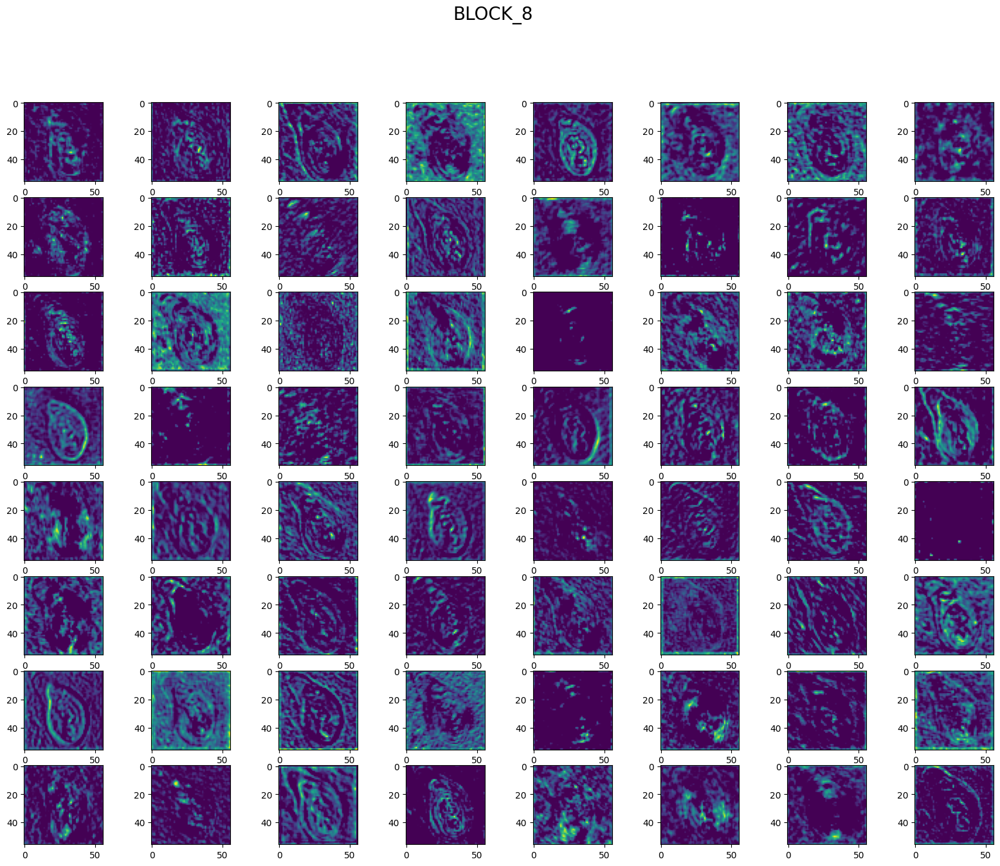

In [ ]:
feature_map = model2.predict(image)  # Predict using model2, which outputs multiple feature maps

for i, fmap in zip(blocks, feature_map):
    fig = pyplot.figure(figsize=(20, 15))
    fig.suptitle("BLOCK_{}".format(i), fontsize=20)

    # Iterate through the channels of the feature map
    for j in range(1, fmap.shape[3] + 1):
        pyplot.subplot(8, 8, j)
        pyplot.imshow(fmap[0, :, :, j - 1])

pyplot.show()

In [ ]:
model2 = VGG16()

blocks = [ 9 ,10,11,12, 13 ,14,15, 17]
outputs = [model2.layers[i].output for i in blocks]

model2 = Model( inputs= model2.inputs, outputs = outputs)

features = model.predict(image)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


ValueError: num must be an integer with 1 <= num <= 64, not 65

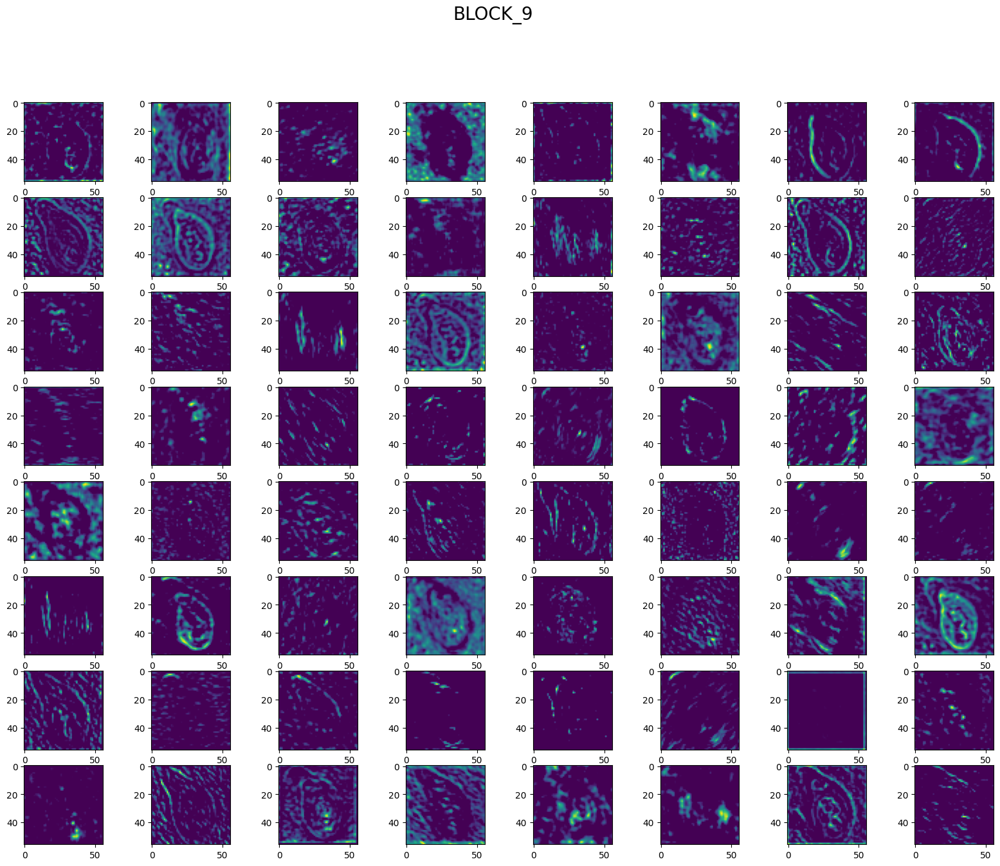

In [ ]:
feature_map = model2.predict(image)  # Predict using model2, which outputs multiple feature maps

for i, fmap in zip(blocks, feature_map):
    fig = pyplot.figure(figsize=(20, 15))
    fig.suptitle("BLOCK_{}".format(i), fontsize=20)

    # Iterate through the channels of the feature map
    for j in range(1, fmap.shape[3] + 1):
        pyplot.subplot(8, 8, j)
        pyplot.imshow(fmap[0, :, :, j - 1])

pyplot.show()

In [ ]:
model2 = VGG16()

blocks = [ 10,11,12]
outputs = [model2.layers[i].output for i in blocks]

model2 = Model( inputs= model2.inputs, outputs = outputs)

features = model.predict(image)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


ValueError: num must be an integer with 1 <= num <= 64, not 65

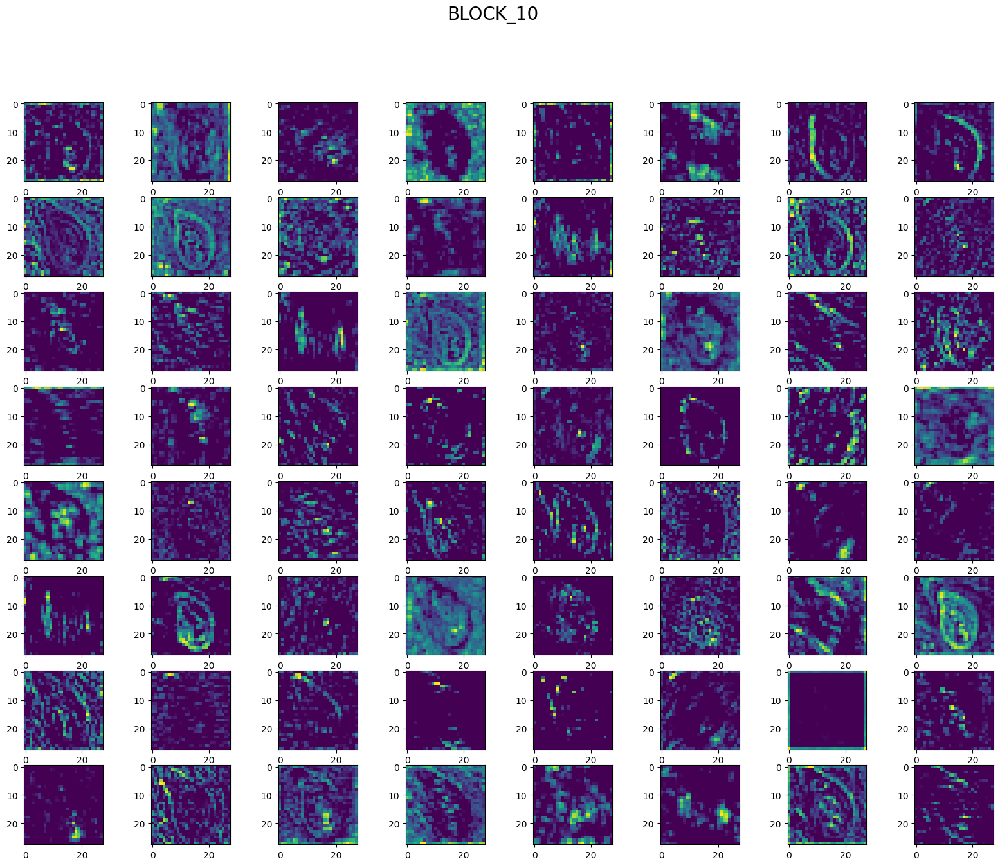

In [ ]:
feature_map = model2.predict(image)  # Predict using model2, which outputs multiple feature maps

for i, fmap in zip(blocks, feature_map):
    fig = pyplot.figure(figsize=(20, 15))
    fig.suptitle("BLOCK_{}".format(i), fontsize=20)

    # Iterate through the channels of the feature map
    for j in range(1, fmap.shape[3] + 1):
        pyplot.subplot(8, 8, j)
        pyplot.imshow(fmap[0, :, :, j - 1])

pyplot.show()

In [ ]:
model2 = VGG16()

blocks = [ 11,12]
outputs = [model2.layers[i].output for i in blocks]

model2 = Model( inputs= model2.inputs, outputs = outputs)

features = model.predict(image)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 967ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


ValueError: num must be an integer with 1 <= num <= 64, not 65

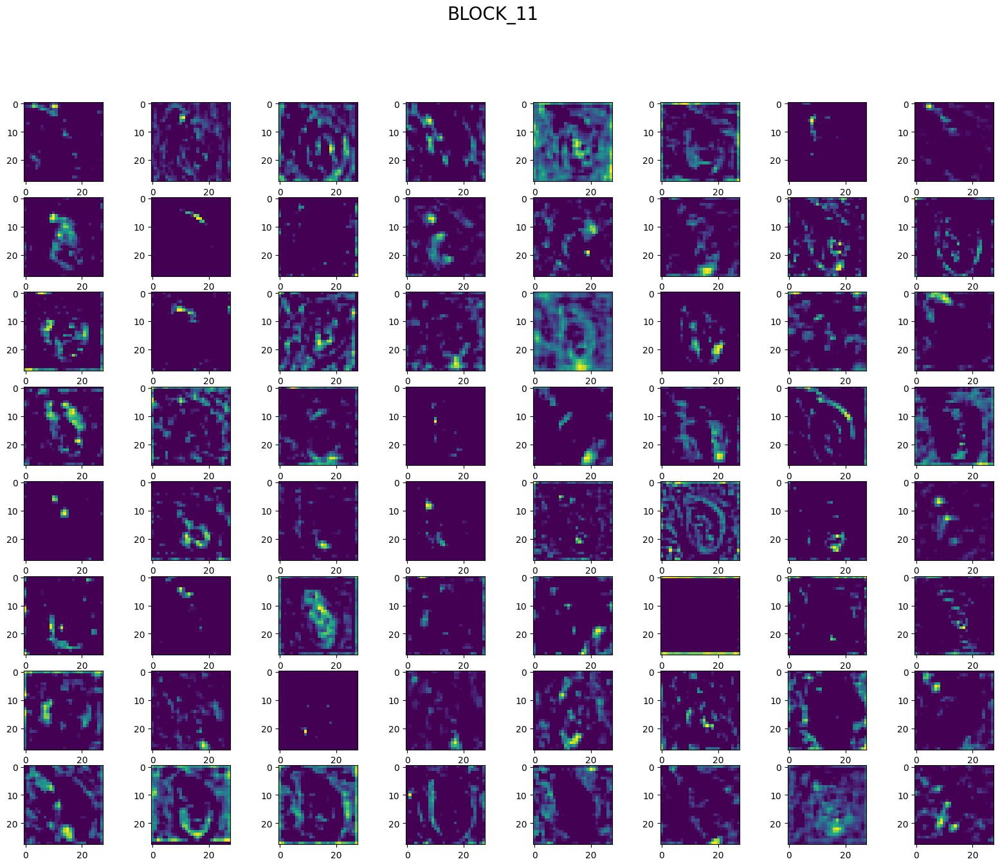

In [ ]:
feature_map = model2.predict(image)  # Predict using model2, which outputs multiple feature maps

for i, fmap in zip(blocks, feature_map):
    fig = pyplot.figure(figsize=(20, 15))
    fig.suptitle("BLOCK_{}".format(i), fontsize=20)

    # Iterate through the channels of the feature map
    for j in range(1, fmap.shape[3] + 1):
        pyplot.subplot(8, 8, j)
        pyplot.imshow(fmap[0, :, :, j - 1])

pyplot.show()